# GTZAN DATASET - MUSIC GENRE CLASSIFICATION

In [2]:
#Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report
import librosa
import librosa.display
import IPython.display as ipd
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import *
import os
import math
import json
import librosa
import warnings
import soundfile as sf
import tensorflow as tf
from tensorflow.keras import optimizers


warnings.filterwarnings("ignore", category = UserWarning, message = "PySoundFile failed. Trying audioread instead.")
warnings.filterwarnings("ignore", category = FutureWarning, message = "librosa.core.audio.__audioread_load.*")

import warnings
warnings.filterwarnings('ignore')

# 1. DATA PREPROCESSING AND EXPLORATION

In [4]:
#Load the dataset in a dataframe with pandas 
project_path = 'C:\MusicGenreClass\Data'
data_df = pd.read_csv(project_path + '/features_3_sec.csv')
data_df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [5]:
#Dataset shape
data_df.shape

(9990, 60)

In [6]:
#Dataset description
data_df.describe()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,9990.0,9990.000000,9990.000000,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,...,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000
mean,66149.0,0.379534,0.084876,0.130859,2.676388e-03,2199.219431,4.166727e+05,2241.385959,1.182711e+05,4566.076592,...,1.448240,49.988755,-4.198706,51.962753,0.739943,52.488851,-2.497306,54.973829,-0.917584,57.322614
std,0.0,0.090466,0.009637,0.068545,3.585628e-03,751.860611,4.349644e+05,543.854449,1.013505e+05,1642.065335,...,5.735149,34.442816,5.677379,36.400669,5.181313,38.177120,5.111799,41.585677,5.253243,46.444212
min,66149.0,0.107108,0.015345,0.000953,4.379535e-08,472.741636,8.118813e+02,499.162910,1.183520e+03,658.336276,...,-26.850016,1.325786,-27.809795,1.624544,-20.733809,3.437439,-27.448456,3.065302,-35.640659,0.282131
25%,66149.0,0.315698,0.079833,0.083782,6.145900e-04,1630.680158,1.231961e+05,1887.455790,4.876553e+04,3378.311110,...,-2.227478,29.584894,-7.951722,29.863448,-2.516638,29.636197,-5.734123,30.496412,-4.004475,30.011365
50%,66149.0,0.384741,0.085108,0.121253,1.491318e-03,2208.628236,2.650692e+05,2230.575595,8.996072e+04,4631.377892,...,1.461623,41.702393,-4.443021,42.393583,0.733772,41.831377,-2.702366,43.435253,-1.030939,44.332155
75%,66149.0,0.442443,0.091092,0.176328,3.130862e-03,2712.581884,5.624152e+05,2588.340505,1.585674e+05,5591.634521,...,5.149752,59.274619,-0.726945,61.676964,3.888734,62.033906,0.514246,65.328602,2.216603,68.210421
max,66149.0,0.749481,0.120964,0.442567,3.261522e-02,5432.534406,4.794119e+06,3708.147554,1.235143e+06,9487.446477,...,39.144405,683.932556,34.048843,529.363342,36.970322,629.729797,31.365425,1143.230591,34.212101,910.473206


In [7]:
#Data types
data_df.dtypes

filename                    object
length                       int64
chroma_stft_mean           float64
chroma_stft_var            float64
rms_mean                   float64
rms_var                    float64
spectral_centroid_mean     float64
spectral_centroid_var      float64
spectral_bandwidth_mean    float64
spectral_bandwidth_var     float64
rolloff_mean               float64
rolloff_var                float64
zero_crossing_rate_mean    float64
zero_crossing_rate_var     float64
harmony_mean               float64
harmony_var                float64
perceptr_mean              float64
perceptr_var               float64
tempo                      float64
mfcc1_mean                 float64
mfcc1_var                  float64
mfcc2_mean                 float64
mfcc2_var                  float64
mfcc3_mean                 float64
mfcc3_var                  float64
mfcc4_mean                 float64
mfcc4_var                  float64
mfcc5_mean                 float64
mfcc5_var           

In [8]:
#List of genres in the dataset

print(list(os.listdir(f'{project_path}/genres_original/')))

['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']


In [9]:
#Count the values for each genre
data_df['label'].value_counts()

label
blues        1000
jazz         1000
metal        1000
pop          1000
reggae       1000
disco         999
classical     998
hiphop        998
rock          998
country       997
Name: count, dtype: int64

*loading a sample from the dataset*

In [10]:
#Load a sample from dataset

#using the project_path variable 

sample = f'{project_path}/genres_original/disco/disco.00055.wav'
data, sr = librosa.load(sample)
print('Data Sample type:',type(data))
print('Disco sample rate:', sr, 'Hz')

Data Sample type: <class 'numpy.ndarray'>
Disco sample rate: 22050 Hz


In [11]:
# Loading data sample with original 'sample rate'
librosa.load(sample, sr = None)

(array([ 0.10012817,  0.07476807,  0.05813599, ..., -0.15820312,
        -0.20874023, -0.1343689 ], dtype=float32),
 22050)

In [12]:
#Playing the sample
ipd.Audio(sample)

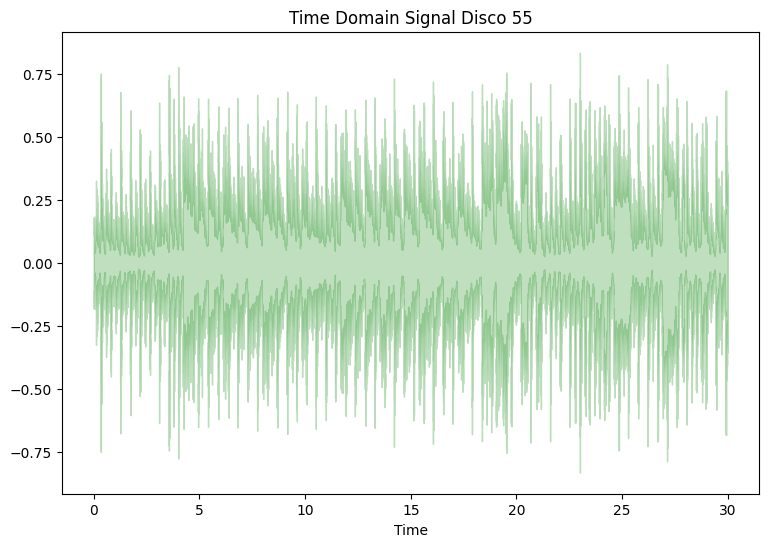

In [13]:
# Explore sample waves
plt.figure(figsize = (9,6))
librosa.display.waveshow(data, color = "green", alpha = 0.25)
plt.title('Time Domain Signal Disco 55')
plt.show()

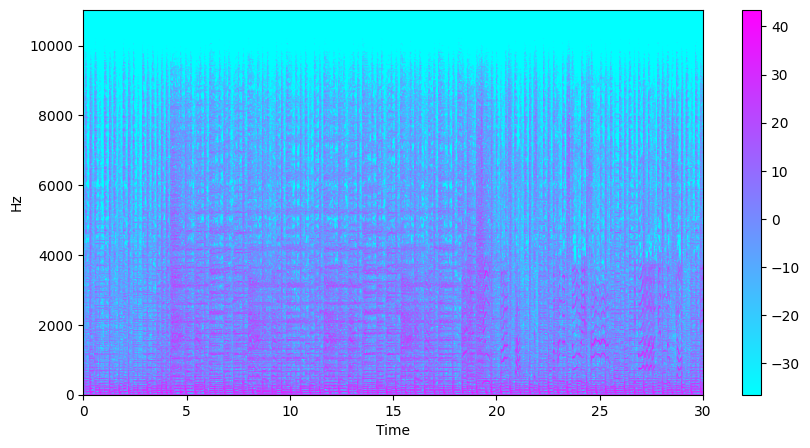

In [14]:
# Sample spectogram
stft = librosa.stft(data)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (10, 5))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap = 'cool')
plt.colorbar()

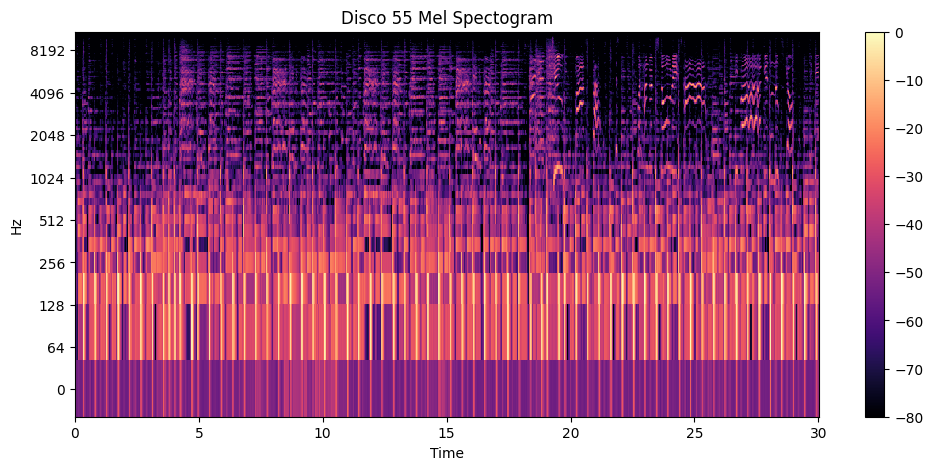

In [15]:
#Sample mel spectogram

m, sr = librosa.load(f'{project_path}/genres_original/disco/disco.00055.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, x_axis = 'time', y_axis = 'log',
                        cmap = 'magma');
plt.colorbar();
plt.title("Disco 55 Mel Spectogram");

*Exploring all genres one by one*

**ROCK**

In [16]:
# Audio sample
sample_rock = f'{project_path}/genres_original/rock/rock.00044.wav'
data_rock, sr = librosa.load(sample_rock)

ipd.Audio(sample_rock) 

Text(0.5, 1.0, 'Rock Sample Wave')

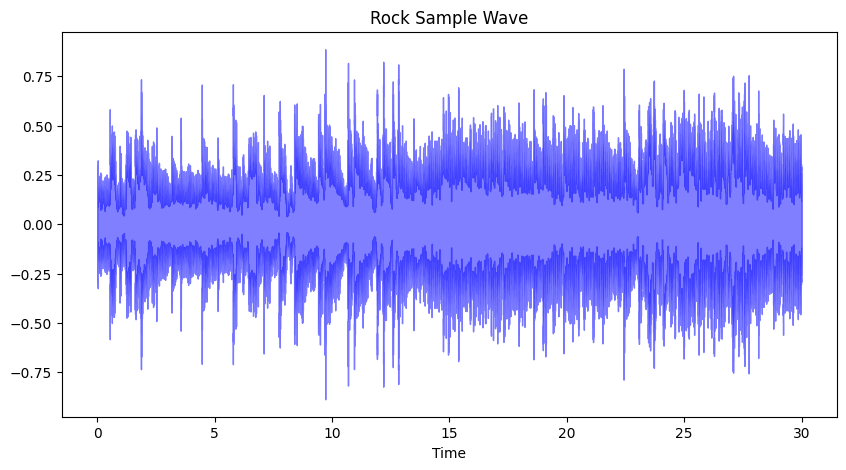

In [17]:
# Rock sample Wave 
plt.figure(figsize = (10, 5))
librosa.display.waveshow(data_rock, sr = sr, color = "blue", alpha = 0.5)
plt.title('Rock Sample Wave')


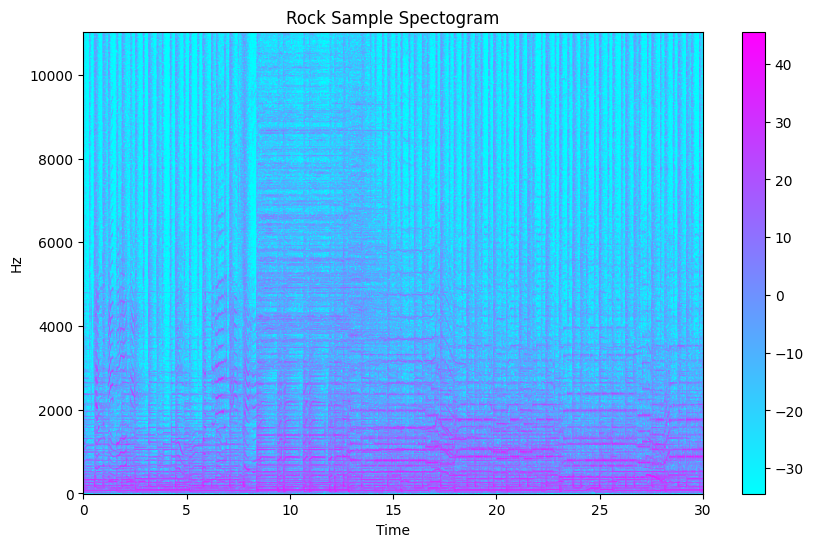

In [18]:
# Rock sample spectrogram
stft = librosa.stft(data_rock)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (10, 6))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap = 'cool')
plt.title('Rock Sample Spectogram')
plt.colorbar()

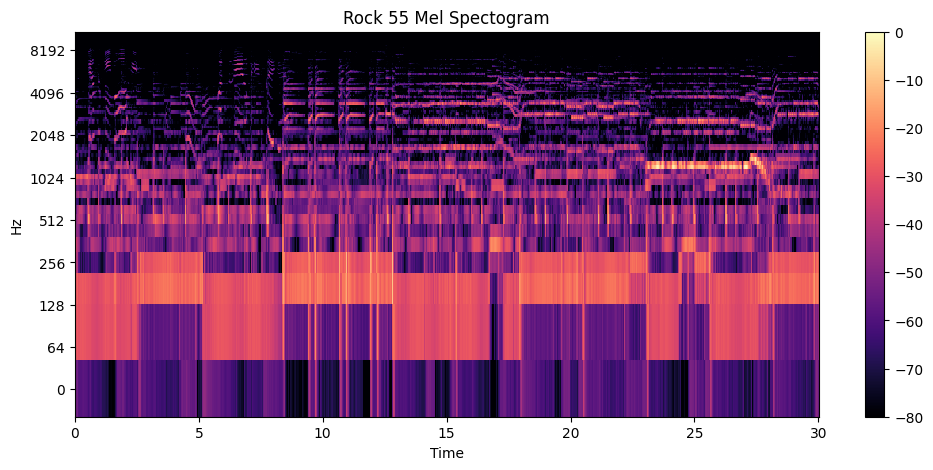

In [19]:
#Rock sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/rock/rock.00044.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log',
                        cmap = 'magma');
plt.colorbar();
plt.title("Rock 55 Mel Spectogram");

**BLUES**

In [20]:
# BLUES sample  
audio_blues = f'{project_path}/genres_original/blues/blues.00025.wav'
data_blues, sr = librosa.load(audio_blues)

# Blues sample audio
ipd.Audio(audio_blues) 

Text(0.5, 1.0, 'BLUES Sample Wave')

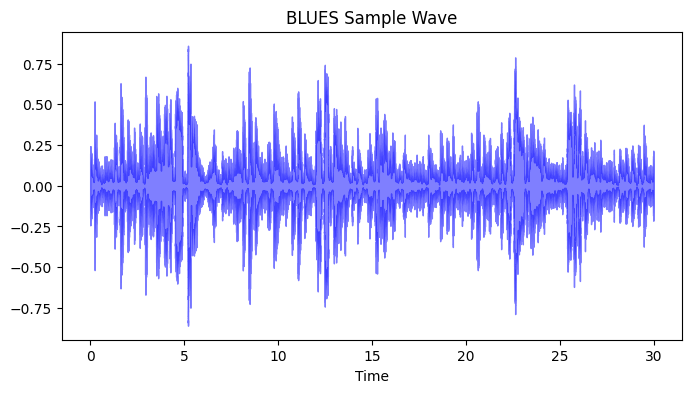

In [21]:
#Blues Sample Wave
plt.figure(figsize=(8, 4))
librosa.display.waveshow(data_blues, sr = sr, color = "blue", alpha = 0.5)
plt.title('BLUES Sample Wave')

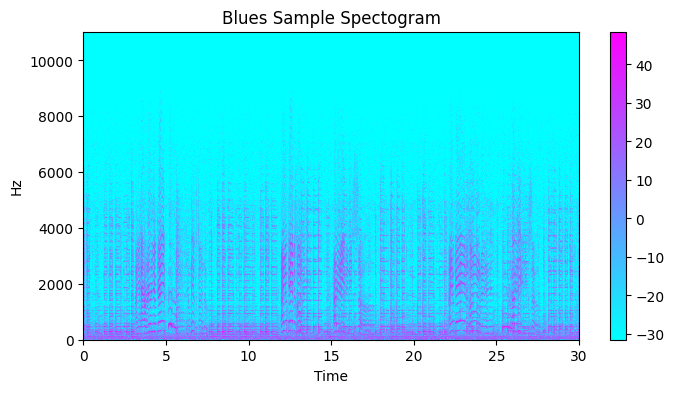

In [22]:
# Blue sample spectrogram
stft = librosa.stft(data_blues)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Blues Sample Spectogram')
plt.colorbar()


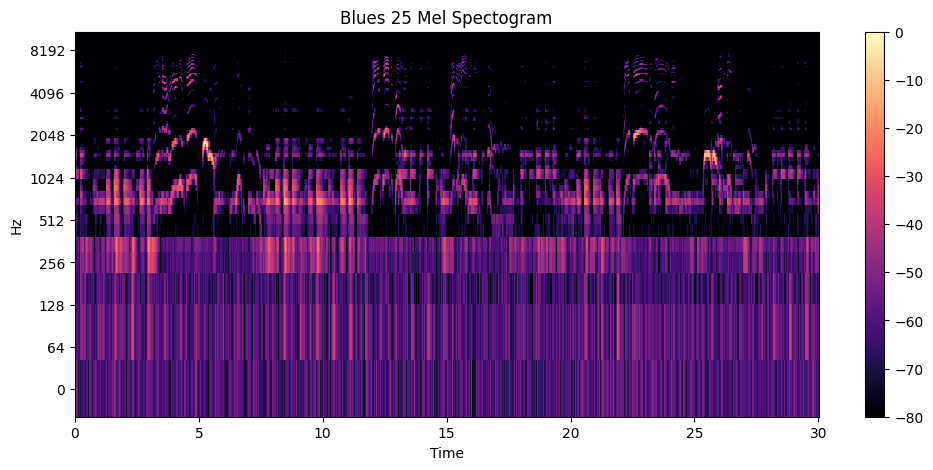

In [23]:
#Blues sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/blues/blues.00025.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log',
                        cmap = 'magma');
plt.colorbar();
plt.title("Blues 25 Mel Spectogram");

**CLASSICAL**

In [24]:
# Classical sample 
audio_classical = f'{project_path}/genres_original/classical/classical.00014.wav'
data_classical, sr = librosa.load(audio_classical)

# Classical sample audio
ipd.Audio(audio_classical) 

Text(0.5, 1.0, 'Classical Sample Wave')

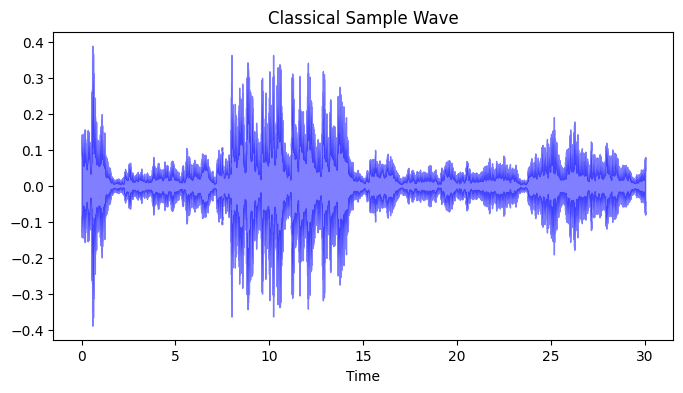

In [25]:
#Classical sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_classical, sr = sr, color = "blue", alpha = 0.5)
plt.title('Classical Sample Wave')



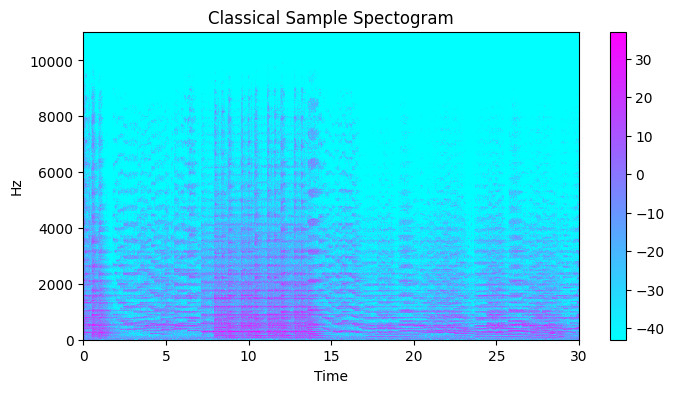

In [26]:
# Classical sample spectrogram
stft = librosa.stft(data_classical)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Classical Sample Spectogram')
plt.colorbar()

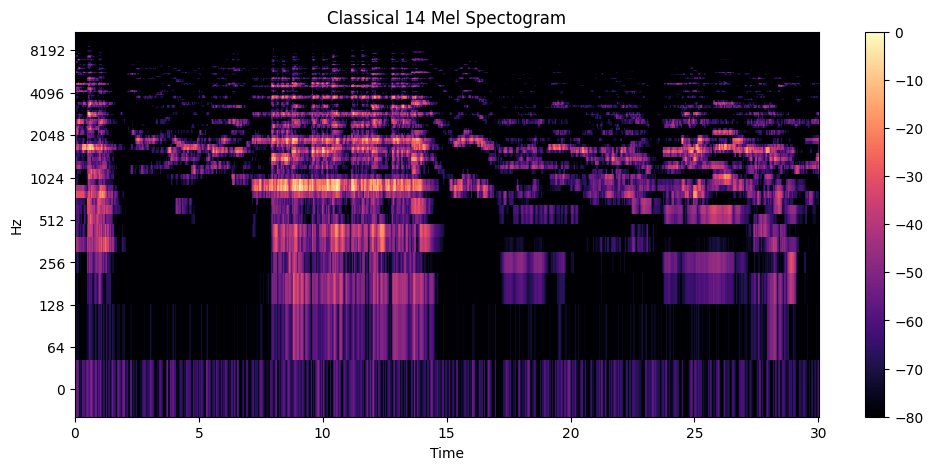

In [27]:
#Classical sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/classical/classical.00014.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Classical 14 Mel Spectogram");

**HIP HOP**

In [28]:
# HIPHOP sample 
audio_hiphop = f'{project_path}/genres_original/hiphop/hiphop.00038.wav'

data_hiphop, sr = librosa.load(audio_hiphop)

# Hiphop sample audio
ipd.Audio(audio_hiphop) 

Text(0.5, 1.0, 'Hiphop Sample Wave')

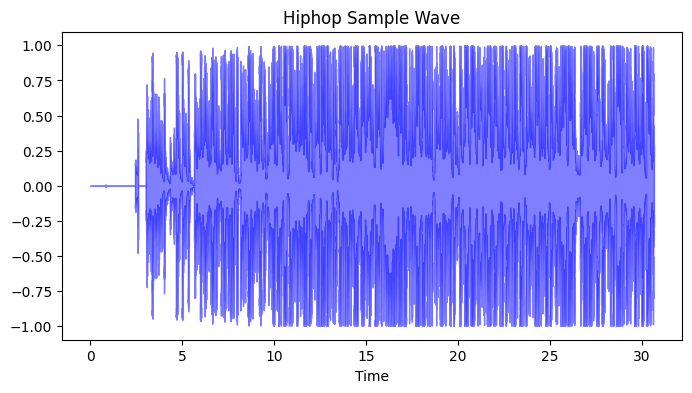

In [29]:
#Hiphop sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_hiphop, sr = sr, color = "blue", alpha = 0.5)
plt.title('Hiphop Sample Wave')


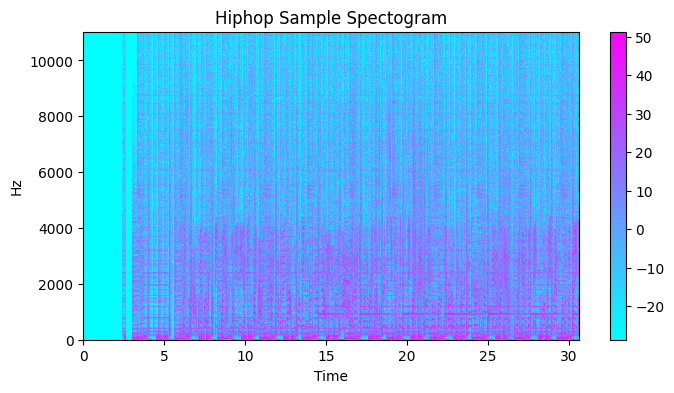

In [30]:
# Hiphop sample Spectrogram
stft = librosa.stft(data_hiphop)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Hiphop Sample Spectogram')
plt.colorbar()

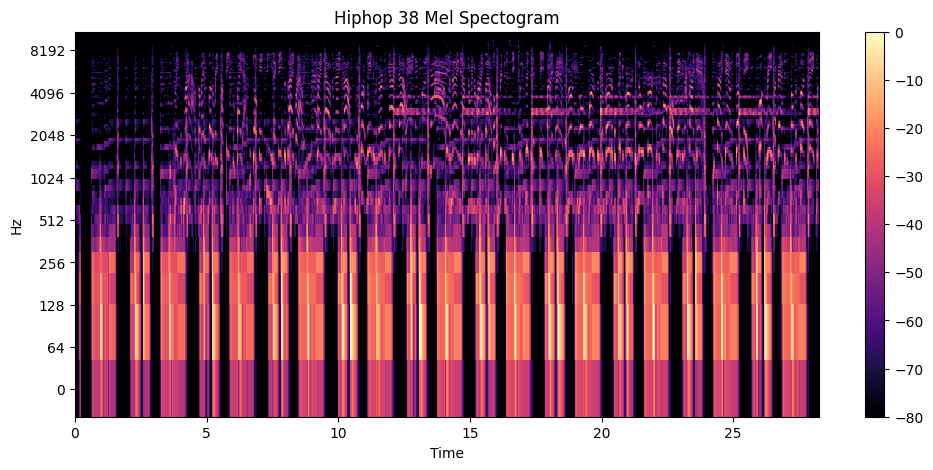

In [31]:
#Hiphop sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/hiphop/hiphop.00038.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Hiphop 38 Mel Spectogram");

**COUNTRY**

In [32]:
# Country sample 
audio_country = f'{project_path}/genres_original/country/country.00070.wav'

data_country, sr = librosa.load(audio_country)

# Country sample audio
ipd.Audio(audio_country) 

Text(0.5, 1.0, 'Country Sample Wave')

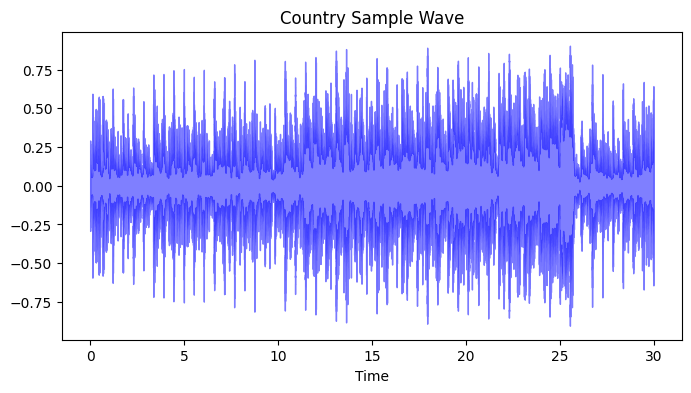

In [33]:
#Country sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_country, sr = sr, color = "blue", alpha = 0.5)
plt.title('Country Sample Wave')


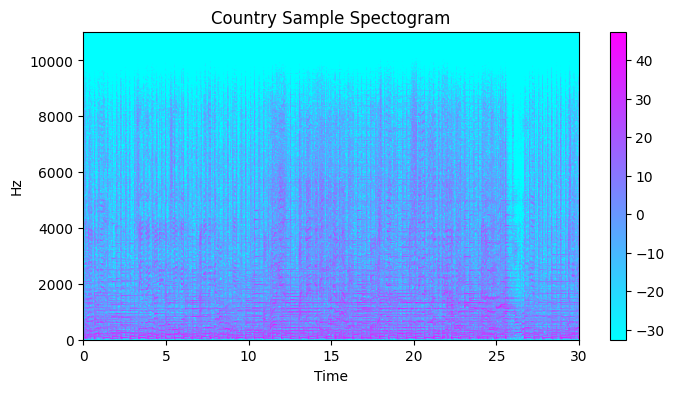

In [34]:
# Country sample spectrogram
stft = librosa.stft(data_country)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap ='cool')
plt.title('Country Sample Spectogram')
plt.colorbar()

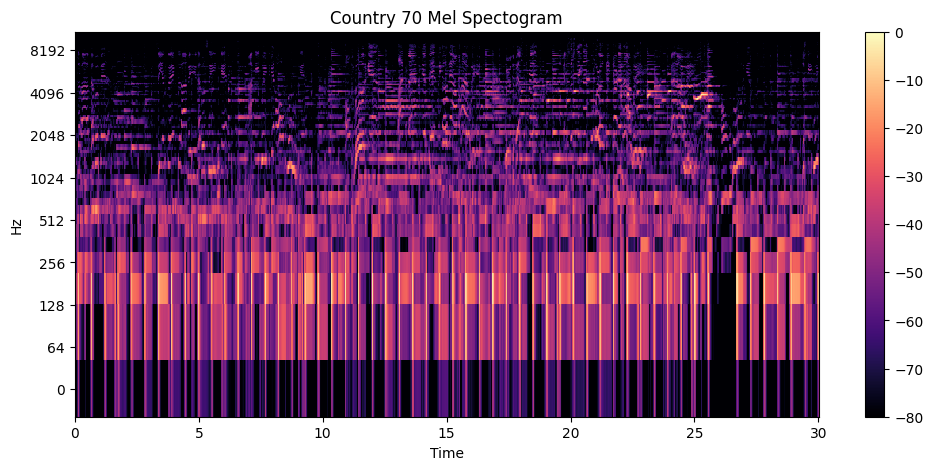

In [35]:
#Country sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/country/country.00070.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Country 70 Mel Spectogram");

**DISCO**

In [36]:

# Disco sample
audio_disco = f'{project_path}/genres_original/disco/disco.00006.wav'
data_disco, sr = librosa.load(audio_disco)

# Sample audio
ipd.Audio(audio_disco) 

Text(0.5, 1.0, 'Disco Sample Wave')

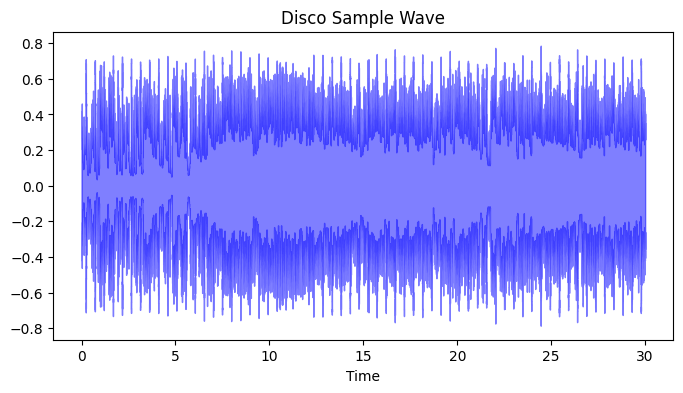

In [37]:
#Disco sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_disco, sr = sr, color = "blue", alpha = 0.5)
plt.title('Disco Sample Wave')

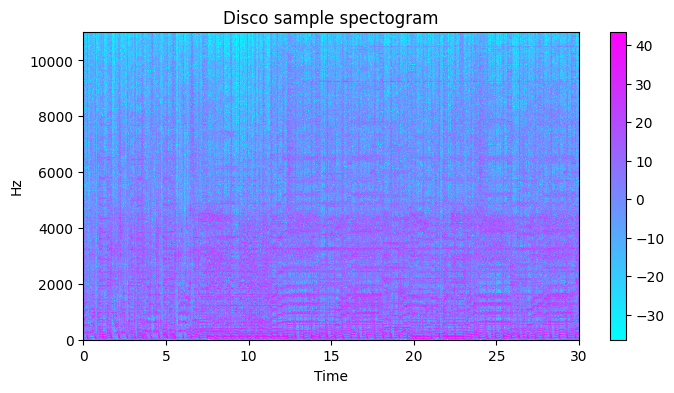

In [38]:
# Disco sample spectrogram
stft = librosa.stft(data_disco)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Disco sample spectogram')
plt.colorbar()


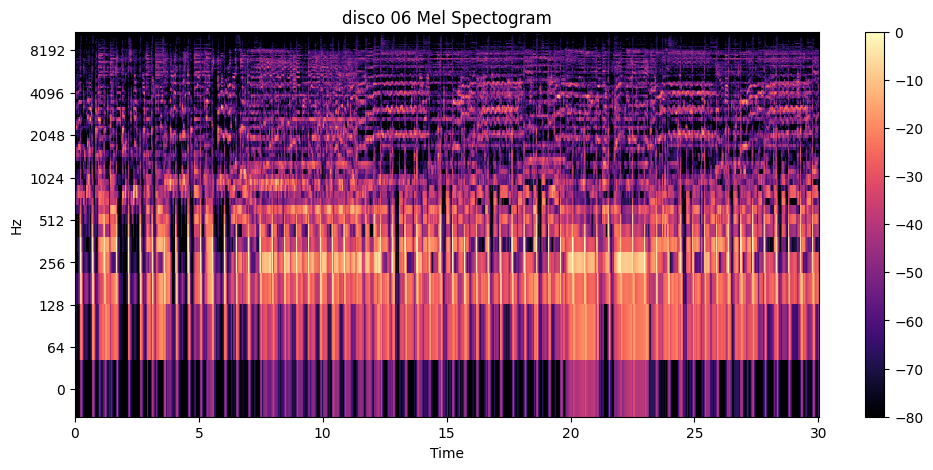

In [39]:
#Country sample mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/disco/disco.00006.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("disco 06 Mel Spectogram");

**JAZZ**

In [40]:

# Jazz Sample Audio   
audio_jazz = f'{project_path}/genres_original/jazz/jazz.00065.wav'
data_jazz, sr = librosa.load(audio_jazz)

# Sample Audio
ipd.Audio(audio_jazz) 

Text(0.5, 1.0, 'Jazz Sample Wave')

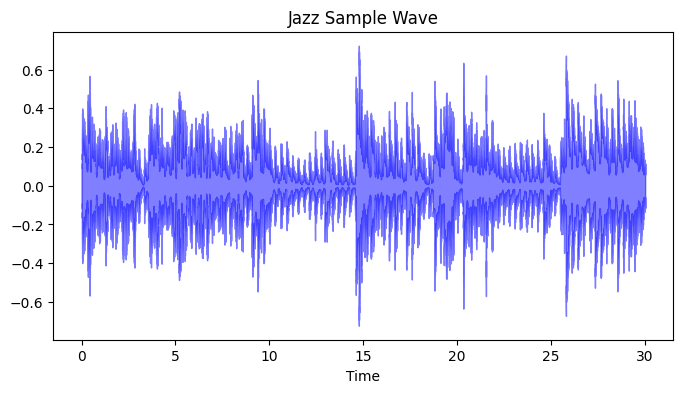

In [41]:
#Jazz sample wave 
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_jazz, sr = sr, color = "blue", alpha = 0.5)
plt.title('Jazz Sample Wave')


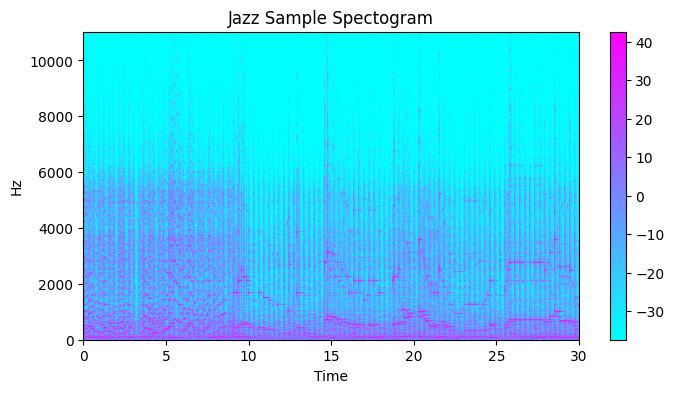

In [42]:
# Jazz sample spectogram 
stft = librosa.stft(data_jazz)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Jazz Sample Spectogram')
plt.colorbar()

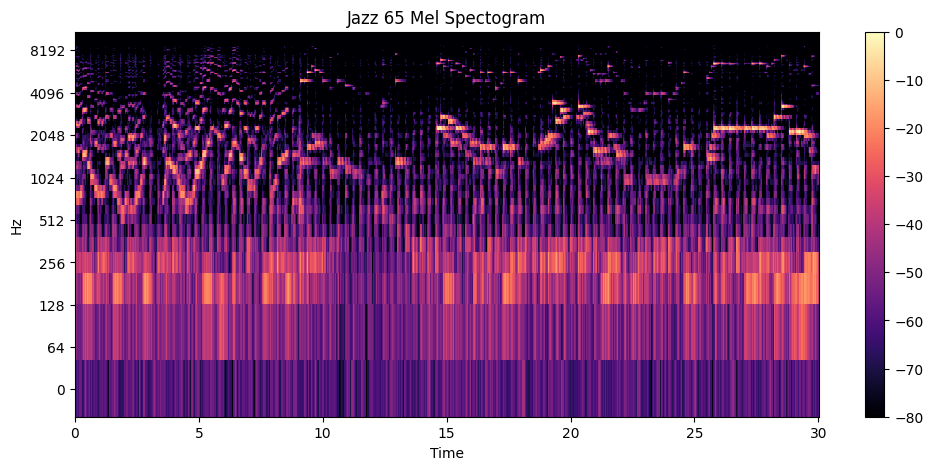

In [43]:
#Jazz sample  mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/jazz/jazz.00065.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Jazz 65 Mel Spectogram");

**METAL**

In [44]:


# Metal sample audio 
audio_metal = f'{project_path}/genres_original/metal/metal.00001.wav'
data_metal, sr = librosa.load(audio_metal)

# Sample audio
ipd.Audio(audio_metal) 

Text(0.5, 1.0, 'Metal Sample Wave')

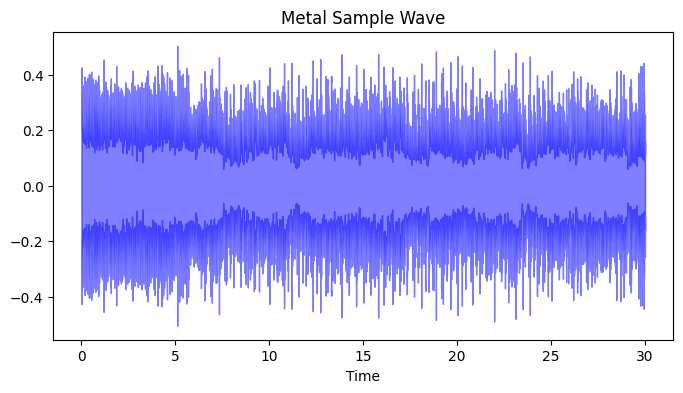

In [45]:
#Metal sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_metal, sr = sr, color = "blue", alpha = 0.5)
plt.title('Metal Sample Wave')

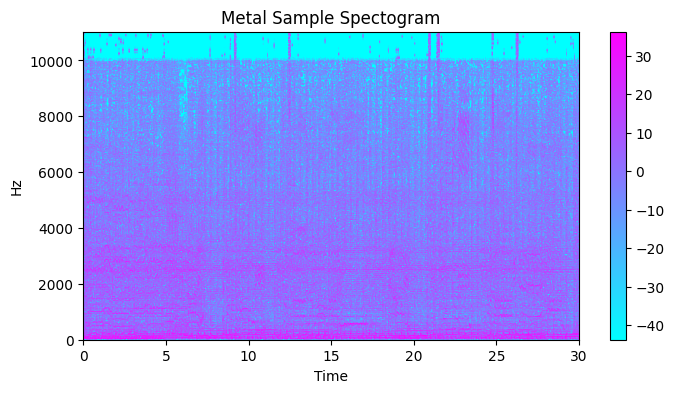

In [46]:
# Metal sample spectrogram
stft = librosa.stft(data_metal)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Metal Sample Spectogram')
plt.colorbar()

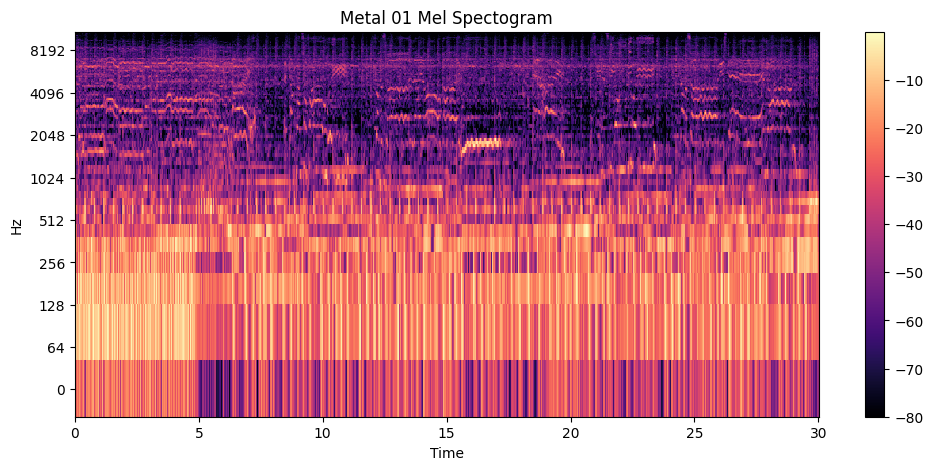

In [47]:
#Metal sample  mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/metal/metal.00001.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Metal 01 Mel Spectogram");

**POP**

In [48]:
# Pop sample audio 
audio_pop = f'{project_path}/genres_original/pop/pop.00088.wav'
data_pop, sr = librosa.load(audio_pop)

# Sample audio
ipd.Audio(audio_pop) 

Text(0.5, 1.0, 'Pop Sample Wave')

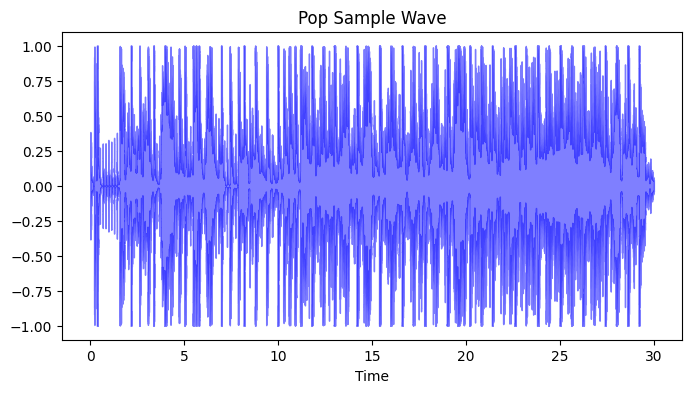

In [49]:
#Pop sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_pop, sr = sr, color = "blue", alpha = 0.5)
plt.title('Pop Sample Wave')


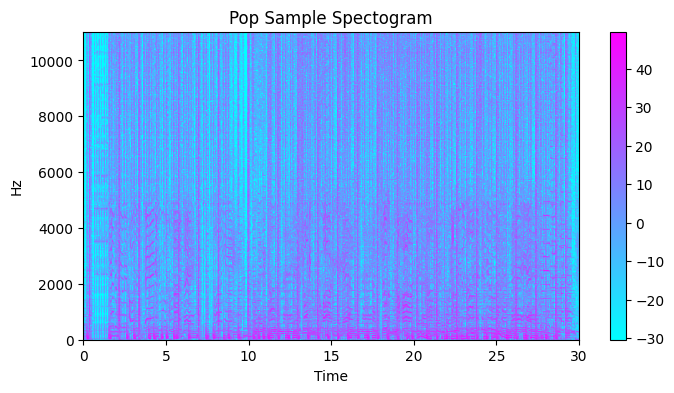

In [50]:
# Pop sample spectogram
stft = librosa.stft(data_pop)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Pop Sample Spectogram')
plt.colorbar()

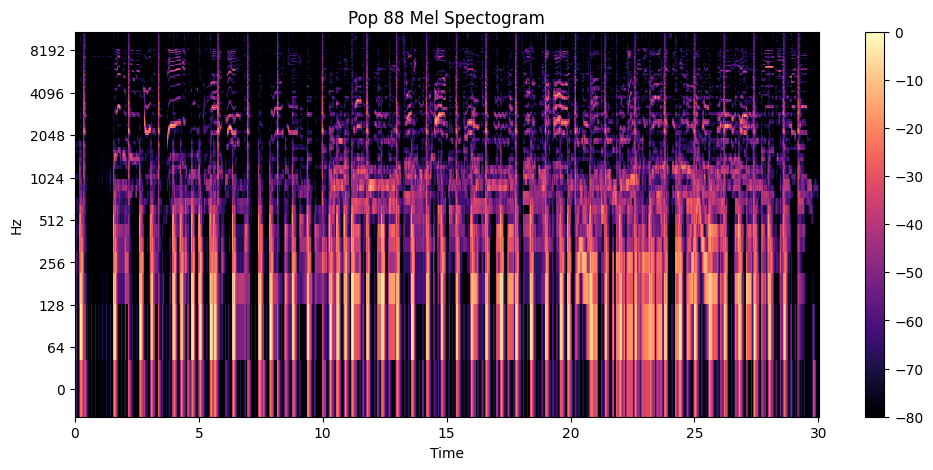

In [51]:
#Pop sample  mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/pop/pop.00088.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Pop 88 Mel Spectogram");

**REGGAE**

In [52]:

#Reggae Sample Audio 
audio_reggae = f'{project_path}/genres_original/reggae/reggae.00010.wav'
data_reggae, sr = librosa.load(audio_reggae)

# Sample audio
ipd.Audio(audio_reggae) 

Text(0.5, 1.0, 'Reggae Sample Wave')

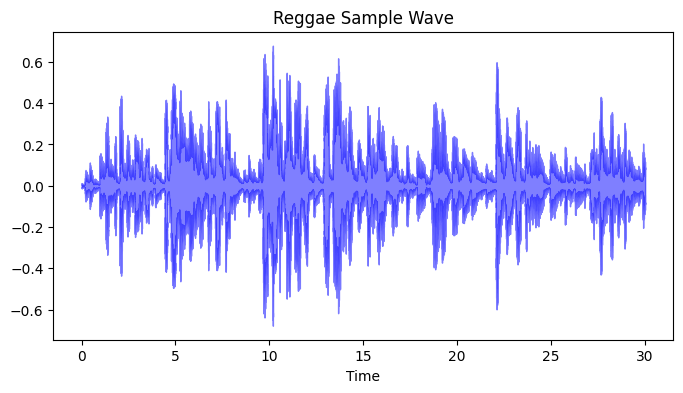

In [53]:
#Reggae sample wave
plt.figure(figsize = (8, 4))
librosa.display.waveshow(data_reggae, sr = sr, color = "blue", alpha = 0.5)
plt.title('Reggae Sample Wave')

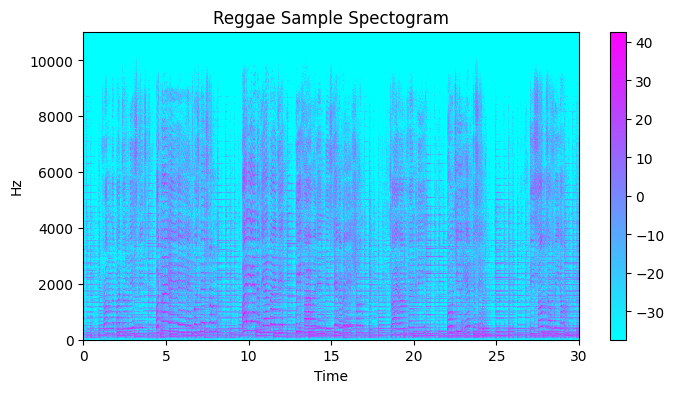

In [54]:
# Reggae sample spectogram
stft = librosa.stft(data_reggae)
stft_db = librosa.amplitude_to_db(abs(stft))
plt.figure(figsize = (8, 4))
librosa.display.specshow(stft_db, sr = sr, x_axis = 'time', y_axis = 'hz', cmap='cool')
plt.title('Reggae Sample Spectogram')
plt.colorbar()

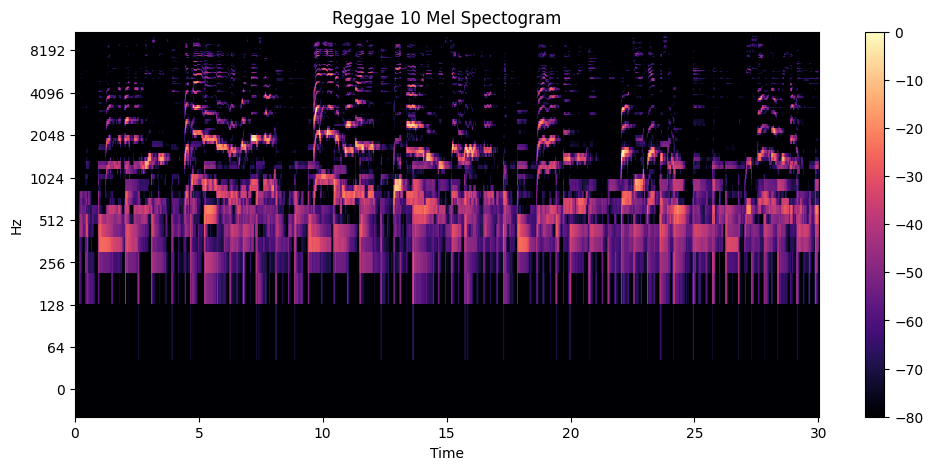

In [55]:
#Reggae sample  mel spectogram
m, sr = librosa.load(f'{project_path}/genres_original/reggae/reggae.00010.wav')
m, _ = librosa.effects.trim(m)


S = librosa.feature.melspectrogram(y=m, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize = (12, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512, x_axis = 'time', y_axis = 'log', cmap = 'magma');
plt.colorbar();
plt.title("Reggae 10 Mel Spectogram");

*Looking for missing values*

In [56]:
# Finding missing values
data_df.isnull().any()   # music_df.isnull().sum()

filename                   False
length                     False
chroma_stft_mean           False
chroma_stft_var            False
rms_mean                   False
rms_var                    False
spectral_centroid_mean     False
spectral_centroid_var      False
spectral_bandwidth_mean    False
spectral_bandwidth_var     False
rolloff_mean               False
rolloff_var                False
zero_crossing_rate_mean    False
zero_crossing_rate_var     False
harmony_mean               False
harmony_var                False
perceptr_mean              False
perceptr_var               False
tempo                      False
mfcc1_mean                 False
mfcc1_var                  False
mfcc2_mean                 False
mfcc2_var                  False
mfcc3_mean                 False
mfcc3_var                  False
mfcc4_mean                 False
mfcc4_var                  False
mfcc5_mean                 False
mfcc5_var                  False
mfcc6_mean                 False
mfcc6_var 

# 2. FEATURE ENGINEERING 

In [57]:
#Dropping 'filename' column
data_df = data_df.drop(labels = "filename", axis = 1)

In [58]:
data_df

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,66149,0.349126,0.080515,0.050019,0.000097,1499.083005,164266.886443,1718.707215,85931.574523,3015.559458,...,42.485981,-9.094270,38.326839,-4.246976,31.049839,-5.625813,48.804092,1.818823,38.966969,rock
9986,66149,0.372564,0.082626,0.057897,0.000088,1847.965128,281054.935973,1906.468492,99727.037054,3746.694524,...,32.415203,-12.375726,66.418587,-3.081278,54.414265,-11.960546,63.452255,0.428857,18.697033,rock
9987,66149,0.347481,0.089019,0.052403,0.000701,1346.157659,662956.246325,1561.859087,138762.841945,2442.362154,...,78.228149,-2.524483,21.778994,4.809936,25.980829,1.775686,48.582378,-0.299545,41.586990,rock
9988,66149,0.387527,0.084815,0.066430,0.000320,2084.515327,203891.039161,2018.366254,22860.992562,4313.266226,...,28.323744,-5.363541,17.209942,6.462601,21.442928,2.354765,24.843613,0.675824,12.787750,rock


In [59]:
# Feature Extraction

labels = data_df.iloc[:, -1]
convertor = LabelEncoder()
y = convertor.fit_transform(labels)
y

array([0, 0, 0, ..., 9, 9, 9])

In [60]:
print(data_df.iloc[:, :-1])

      length  chroma_stft_mean  chroma_stft_var  rms_mean   rms_var  \
0      66149          0.335406         0.091048  0.130405  0.003521   
1      66149          0.343065         0.086147  0.112699  0.001450   
2      66149          0.346815         0.092243  0.132003  0.004620   
3      66149          0.363639         0.086856  0.132565  0.002448   
4      66149          0.335579         0.088129  0.143289  0.001701   
...      ...               ...              ...       ...       ...   
9985   66149          0.349126         0.080515  0.050019  0.000097   
9986   66149          0.372564         0.082626  0.057897  0.000088   
9987   66149          0.347481         0.089019  0.052403  0.000701   
9988   66149          0.387527         0.084815  0.066430  0.000320   
9989   66149          0.369293         0.086759  0.050524  0.000067   

      spectral_centroid_mean  spectral_centroid_var  spectral_bandwidth_mean  \
0                1773.065032          167541.630869              19

In [61]:
# Scaling

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = scaler.fit_transform(np.array(data_df.iloc[:, :-1], dtype = float))


In [62]:
print(x.shape)  
print(y.shape)  


(9990, 58)
(9990,)


In [63]:
#Split data in training and test.
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.33)

In [64]:
len(y_train)

6693

In [65]:
x_train.shape, x_test.shape

((6693, 58), (3297, 58))

In [66]:
y_train.shape, y_test.shape

((6693,), (3297,))

# 3. MODEL SELECTION

In [67]:
# Logistic Regression
log_reg = LogisticRegression(max_iter=1000)
log_reg.fit(x_train, y_train)
y_pred_log_reg = log_reg.predict(x_test)
print("Logistic Regression Accuracy:", accuracy_score(y_test, y_pred_log_reg))
print(classification_report(y_test, y_pred_log_reg))

log_reg_acc = accuracy_score(y_test, log_reg.predict(x_test))


Logistic Regression Accuracy: 0.7173187746436154
              precision    recall  f1-score   support

           0       0.69      0.70      0.69       343
           1       0.90      0.93      0.91       294
           2       0.71      0.65      0.68       340
           3       0.65      0.65      0.65       330
           4       0.72      0.65      0.68       332
           5       0.76      0.81      0.78       351
           6       0.77      0.86      0.81       322
           7       0.80      0.80      0.80       331
           8       0.63      0.65      0.64       316
           9       0.54      0.50      0.52       338

    accuracy                           0.72      3297
   macro avg       0.72      0.72      0.72      3297
weighted avg       0.72      0.72      0.72      3297



In [68]:
# Decision Tree Classifier
tree_clf = DecisionTreeClassifier()
tree_clf.fit(x_train, y_train)
y_pred_tree = tree_clf.predict(x_test)
print("Decision Tree Accuracy:", accuracy_score(y_test, y_pred_tree))
print(classification_report(y_test, y_pred_tree))

tree_acc = accuracy_score(y_test, tree_clf.predict(x_test))


Decision Tree Accuracy: 0.6348195329087049
              precision    recall  f1-score   support

           0       0.62      0.59      0.61       343
           1       0.82      0.85      0.83       294
           2       0.57      0.56      0.56       340
           3       0.53      0.54      0.54       330
           4       0.62      0.64      0.63       332
           5       0.68      0.66      0.67       351
           6       0.72      0.79      0.75       322
           7       0.72      0.66      0.69       331
           8       0.58      0.61      0.60       316
           9       0.50      0.47      0.49       338

    accuracy                           0.63      3297
   macro avg       0.64      0.64      0.64      3297
weighted avg       0.63      0.63      0.63      3297



In [69]:
# Support Vector Classifier
svm_clf = SVC()
svm_clf.fit(x_train, y_train)
y_pred_svm = svm_clf.predict(x_test)
print("SVM Accuracy:", accuracy_score(y_test, y_pred_svm))
print(classification_report(y_test, y_pred_svm))

svm_acc = accuracy_score(y_test, svm_clf.predict(x_test))


SVM Accuracy: 0.8462238398544131
              precision    recall  f1-score   support

           0       0.88      0.86      0.87       343
           1       0.87      0.98      0.92       294
           2       0.81      0.81      0.81       340
           3       0.79      0.82      0.80       330
           4       0.91      0.79      0.85       332
           5       0.86      0.89      0.87       351
           6       0.87      0.93      0.90       322
           7       0.90      0.86      0.88       331
           8       0.83      0.83      0.83       316
           9       0.75      0.72      0.73       338

    accuracy                           0.85      3297
   macro avg       0.85      0.85      0.85      3297
weighted avg       0.85      0.85      0.85      3297



In [70]:
# Artificial Neural Network (ANN)
ann_model = Sequential()
ann_model.add(Dense(128, input_shape=(x_train.shape[1],), activation='relu'))
ann_model.add(Dropout(0.5))
ann_model.add(Dense(64, activation='relu'))
ann_model.add(Dropout(0.5))
ann_model.add(Dense(10, activation='softmax'))

ann_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
ann_model.fit(x_train, y_train, epochs=50, batch_size=32, verbose=2)

y_pred_ann = np.argmax(ann_model.predict(x_test), axis=-1)
print("ANN Accuracy:", accuracy_score(y_test, y_pred_ann))
print(classification_report(y_test, y_pred_ann))

y_pred_ann = np.argmax(ann_model.predict(x_test), axis=-1)
ann_acc = accuracy_score(y_test, y_pred_ann)


Epoch 1/50
210/210 - 2s - 7ms/step - accuracy: 0.2867 - loss: 2.0278
Epoch 2/50
210/210 - 0s - 2ms/step - accuracy: 0.4307 - loss: 1.5865
Epoch 3/50
210/210 - 0s - 2ms/step - accuracy: 0.4916 - loss: 1.4221
Epoch 4/50
210/210 - 0s - 2ms/step - accuracy: 0.5313 - loss: 1.3036
Epoch 5/50
210/210 - 0s - 2ms/step - accuracy: 0.5672 - loss: 1.2363
Epoch 6/50
210/210 - 0s - 2ms/step - accuracy: 0.5899 - loss: 1.1659
Epoch 7/50
210/210 - 0s - 2ms/step - accuracy: 0.6071 - loss: 1.1202
Epoch 8/50
210/210 - 0s - 2ms/step - accuracy: 0.6280 - loss: 1.0580
Epoch 9/50
210/210 - 0s - 2ms/step - accuracy: 0.6407 - loss: 1.0372
Epoch 10/50
210/210 - 0s - 2ms/step - accuracy: 0.6459 - loss: 1.0310
Epoch 11/50
210/210 - 0s - 2ms/step - accuracy: 0.6546 - loss: 1.0106
Epoch 12/50
210/210 - 0s - 2ms/step - accuracy: 0.6655 - loss: 0.9735
Epoch 13/50
210/210 - 0s - 2ms/step - accuracy: 0.6683 - loss: 0.9609
Epoch 14/50
210/210 - 0s - 2ms/step - accuracy: 0.6762 - loss: 0.9255
Epoch 15/50
210/210 - 0s - 2m

In [71]:
# Recurrent Neural Network (RNN)
rnn_model = Sequential()
rnn_model.add(LSTM(128, input_shape=(x_train.shape[1], 1), return_sequences=True))
rnn_model.add(Dropout(0.5))
rnn_model.add(LSTM(64, return_sequences=False))
rnn_model.add(Dropout(0.5))
rnn_model.add(Dense(10, activation='softmax'))

rnn_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Reshape data for RNN
x_train_rnn = np.expand_dims(x_train, axis=2)
x_test_rnn = np.expand_dims(x_test, axis=2)
rnn_model.fit(x_train_rnn, y_train, epochs=50, batch_size=32, verbose=2)

y_pred_rnn = np.argmax(rnn_model.predict(x_test_rnn), axis=-1)
print("RNN Accuracy:", accuracy_score(y_test, y_pred_rnn))
print(classification_report(y_test, y_pred_rnn))

y_pred_rnn = np.argmax(rnn_model.predict(x_test_rnn), axis=-1)
rnn_acc = accuracy_score(y_test, y_pred_rnn)


Epoch 1/50
210/210 - 12s - 57ms/step - accuracy: 0.2722 - loss: 1.9282
Epoch 2/50
210/210 - 9s - 44ms/step - accuracy: 0.3572 - loss: 1.7405
Epoch 3/50
210/210 - 9s - 44ms/step - accuracy: 0.3765 - loss: 1.6728
Epoch 4/50
210/210 - 10s - 45ms/step - accuracy: 0.4067 - loss: 1.6258
Epoch 5/50
210/210 - 10s - 46ms/step - accuracy: 0.4203 - loss: 1.5773
Epoch 6/50
210/210 - 10s - 48ms/step - accuracy: 0.4455 - loss: 1.5306
Epoch 7/50
210/210 - 10s - 49ms/step - accuracy: 0.4545 - loss: 1.5092
Epoch 8/50
210/210 - 10s - 48ms/step - accuracy: 0.4688 - loss: 1.4955
Epoch 9/50
210/210 - 10s - 47ms/step - accuracy: 0.4821 - loss: 1.4611
Epoch 10/50
210/210 - 10s - 50ms/step - accuracy: 0.4960 - loss: 1.4157
Epoch 11/50
210/210 - 11s - 54ms/step - accuracy: 0.5135 - loss: 1.3935
Epoch 12/50
210/210 - 12s - 56ms/step - accuracy: 0.5077 - loss: 1.3816
Epoch 13/50
210/210 - 14s - 66ms/step - accuracy: 0.5259 - loss: 1.3453
Epoch 14/50
210/210 - 12s - 59ms/step - accuracy: 0.5309 - loss: 1.3320
Epo

In [72]:

DATASET_PATH = project_path + '/genres_original'
JSON_PATH = "data_10.json"
SAMPLE_RATE = 22050
TRACK_DURATION = 30
SAMPLES_PER_TRACK = SAMPLE_RATE * TRACK_DURATION

def save_mfcc(dataset_path, json_path, num_mfcc=13, n_fft=2048, hop_length=512, num_segments=5):
    data = {
        "mapping": [],
        "labels": [],
        "mfcc": []
    }
    
    samples_per_segment = int(SAMPLES_PER_TRACK / num_segments)
    num_mfcc_vectors_per_segment = math.ceil(samples_per_segment / hop_length)
    
    for i, (dirpath, dirnames, filenames) in enumerate(os.walk(dataset_path)):
        if dirpath != dataset_path:
            semantic_label = dirpath.split("/")[-1]
            data["mapping"].append(semantic_label)
            print(semantic_label)
            for f in filenames:
                file_path = os.path.join(dirpath, f)
                
                # Check if the file format is supported
                try:
                    sf.info(file_path)
                except:
                    print(f"Skipping file {file_path} due to unsupported format.")
                    continue
                
                signal, sample_rate = librosa.load(file_path, sr=SAMPLE_RATE)
                for d in range(num_segments):
                    start = samples_per_segment * d
                    finish = start + samples_per_segment
                    mfcc = librosa.feature.mfcc(y = signal[start:finish], sr = sample_rate, n_mfcc = num_mfcc, n_fft = n_fft, hop_length = hop_length)
                    mfcc = mfcc.T
                    if len(mfcc) == num_mfcc_vectors_per_segment:
                        data["mfcc"].append(mfcc.tolist())
                        data["labels"].append(i-1)
    
    with open(json_path, "w") as fp:
        json.dump(data, fp, indent = 4)

save_mfcc(DATASET_PATH, JSON_PATH, num_segments = 15)


genres_original\blues
genres_original\classical
genres_original\country
genres_original\disco
genres_original\hiphop
genres_original\jazz
Skipping file C:\MusicGenreClass\Data/genres_original\jazz\jazz.00054.wav due to unsupported format.
genres_original\metal
genres_original\pop
genres_original\reggae
genres_original\rock


In [73]:
DATA_PATH = "./data_10.json"
def load_data(data_path):

    with open(data_path, "r") as fp:
        data = json.load(fp)

    x = np.array(data["mfcc"])
    y = np.array(data["labels"])
    z = np.array(data['mapping'])
    return x, y, z

In [74]:
def prepare_datasets(test_size, validation_size):
    x, y, z = load_data(DATA_PATH)
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = test_size, shuffle = True,random_state =42)
    x_train, x_validation, y_train, y_validation = train_test_split(x_train, y_train, test_size=1, shuffle = True, random_state = 42)

    # add an axis to input sets
    x_train = x_train[..., np.newaxis]
    x_validation = x_validation[..., np.newaxis]
    x_test = x_test[..., np.newaxis]

    return x_train, x_validation, x_test, y_train, y_validation, y_test, z

In [75]:
x_train.shape, x_test.shape

((6693, 58), (3297, 58))

In [76]:
x_train, x_validation, x_test, y_train, y_validation, y_test, z = prepare_datasets(0.1, 0)

In [77]:
def build_model(input_shape):
    model = Sequential()
    
    #1st conv layer
    model.add(Conv2D(32, (2, 2), activation='relu', input_shape=input_shape, kernel_initializer = 'he_normal'))
    model.add(MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())

    # 2nd conv layer
    model.add(Conv2D(64, (2, 2), activation='relu', kernel_initializer = 'he_normal'))
    model.add(MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    
    # 3rd conv layer
    model.add(Conv2D(128, (2, 2), activation='relu', kernel_initializer = 'he_normal'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())

    # flatten output and feed it into dense layer
    model.add(Flatten())
    model.add(Dense(128, activation='relu', kernel_initializer = 'he_normal'))
    model.add(Dropout(0.5))
    model.add(Dense(64, activation='relu', kernel_initializer = 'he_normal'))
    model.add(Dropout(0.5))
    
    # output layer
    model.add(Dense(10, activation='softmax'))
    return model

In [78]:
input_shape = (x_train.shape[1], x_train.shape[2], 1)
model = build_model(input_shape)
optimiser = optimizers.Adam(learning_rate=0.0025)
model.compile(optimizer = optimiser, loss = 'sparse_categorical_crossentropy', metrics = ['accuracy']) #Most basic optimizer 
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 86, 12, 32)     │           160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 43, 6, 32)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 43, 6, 32)      │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 42, 5, 64)      │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 21, 3, 64)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 21, 3, 64)      │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 20, 2, 128)     │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 10, 1, 128)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 10, 1, 128)     │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 215,082 (840.16 KB)

 Trainable params: 214,634 (838.41 KB)

 Non-trainable params: 448 (1.75 KB)

In [79]:
#Training the model 
history = model.fit(x_train, y_train, validation_data = (x_test, y_test), batch_size = 512, epochs = 75, verbose = 2) 

Epoch 1/75
27/27 - 8s - 293ms/step - accuracy: 0.2814 - loss: 2.4074 - val_accuracy: 0.1756 - val_loss: 4.2350
Epoch 2/75
27/27 - 5s - 180ms/step - accuracy: 0.4043 - loss: 1.6871 - val_accuracy: 0.2163 - val_loss: 2.6027
Epoch 3/75
27/27 - 5s - 181ms/step - accuracy: 0.4740 - loss: 1.4723 - val_accuracy: 0.2283 - val_loss: 3.2704
Epoch 4/75
27/27 - 5s - 192ms/step - accuracy: 0.5224 - loss: 1.3315 - val_accuracy: 0.2583 - val_loss: 1.9637
Epoch 5/75
27/27 - 5s - 185ms/step - accuracy: 0.5606 - loss: 1.2398 - val_accuracy: 0.3718 - val_loss: 1.6254
Epoch 6/75
27/27 - 5s - 190ms/step - accuracy: 0.5929 - loss: 1.1510 - val_accuracy: 0.4866 - val_loss: 1.4154
Epoch 7/75
27/27 - 5s - 186ms/step - accuracy: 0.6220 - loss: 1.0867 - val_accuracy: 0.5360 - val_loss: 1.2802
Epoch 8/75
27/27 - 5s - 192ms/step - accuracy: 0.6525 - loss: 1.0028 - val_accuracy: 0.5487 - val_loss: 1.2373
Epoch 9/75
27/27 - 5s - 200ms/step - accuracy: 0.6749 - loss: 0.9442 - val_accuracy: 0.6575 - val_loss: 0.9580
E

In [80]:
#Saving the cnn accuracy values to compare
y_pred_cnn = np.argmax(model.predict(x_test), axis=-1)
cnn_acc = accuracy_score(y_test, y_pred_cnn)

47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


In [81]:
#Evaluate the training model 
train_loss, train_acc = model.evaluate(x_train, y_train, verbose = 2)
print('\nTrain Accuracy :', train_acc)
print('\nTrain Loss :', train_loss)

422/422 - 3s - 7ms/step - accuracy: 0.9838 - loss: 0.0520

Train Accuracy : 0.9837501049041748

Train Loss : 0.0520489476621151


In [82]:
#Evaluate the model with test data
test_loss, test_acc = model.evaluate(x_test, y_test, verbose = 2)
print('\nTest Accuracy :', test_acc)
print('\nTest Loss :', test_loss)

47/47 - 0s - 8ms/step - accuracy: 0.8104 - loss: 1.1827

Test Accuracy : 0.8104138970375061

Test Loss : 1.1826605796813965


In [83]:
# Diccionario con los nombres de los modelos y sus precisiones
accuracy_results = {
    "Model": ["Logistic Regression", "Decision Trees", "SVM", "ANN", "RNN", "CNN"],
    "Accuracy": [log_reg_acc, tree_acc, svm_acc, ann_acc, rnn_acc, cnn_acc]
}

# Crear un DataFrame
results_df = pd.DataFrame(accuracy_results)

# Mostrar la tabla
print(results_df)

                 Model  Accuracy
0  Logistic Regression  0.717319
1       Decision Trees  0.634820
2                  SVM  0.846224
3                  ANN  0.825599
4                  RNN  0.690931
5                  CNN  0.810414


In [84]:
#Create a predict function
def predict(model, x, y, z):
    if x.ndim == 3:  
        x = x[np.newaxis, ...]

    # Prediction
    prediction = model.predict(x)
    predicted_index = np.argmax(prediction, axis=1)
    
    # Get target and predicted label 
    target = z[y]
    predicted = z[predicted_index[0]]

    print("\nActual Label: {}\nPredicted Label: {}".format(target, predicted)) 


In [85]:
# List of genres
z = ['classical', 'blues', 'jazz', 'hiphop', 'rock', 'pop', 'metal', 'country', 'disco', 'reggae']

# Getting a sample to predict
x_to_predict = x_test[180]
y_to_predict = y_test[180]

# Sample prediction
predict(model, x_to_predict, y_to_predict, z)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

Actual Label: pop
Predicted Label: pop


# Step 7: Saving our model

In [86]:
#Let's save our model to h5 file
model.save('music_model.h5')